In [1]:
import pathlib
import os

import h5py
import pandas as pd
import json
import numpy as np
import scipy as sp
from matplotlib import pyplot as plt
import dask.array as da
import dask.dataframe as dd
import skimage 
import cloudpickle


import SessionTools.two_photon as st2p
plt.rcParams.update({'font.size':18})

%load_ext autoreload
%autoreload 2 

%matplotlib inline

In [2]:
outdir = pathlib.Path('/media/mplitt/SSD_storage1/fig_scratch/cosyne_2024/')

In [34]:
def plot_dual_imaging(data, start_frame=0, stop_frame=-1, plot_time=False, pva_scatter=True):
    if stop_frame == -1:
        stop_frame = data['dff_EB'].shape[-1]
    window = slice(start_frame, stop_frame)
    
    time = data['df_aligned']['Time(ms)'].to_numpy()
    time[window]
    
    x = np.arange(stop_frame-start_frame)
    fig, ax = plt.subplots(3,1,figsize=[12,6], sharex=True)
    
    dff_EB, dff_R4d = data['dff_EB'][:,window], data['dff_R4d'][:,window]
    heading = data['heading'][window]
    
    # phi_EB = np.angle(sp.ndimage.gaussian_filter1d(np.exp(1j*data['phi_EB'][window]),1))
    # phi_R4d = np.angle(sp.ndimage.gaussian_filter1d(np.exp(1j*data['phi_R4d'][window]),1))
    phi_EB = data['phi_EB'][window]
    phi_R4d = data['phi_R4d'][window]
    
    offset_EB = np.angle(np.exp(1j*(phi_EB-heading)))
    offset_R4d = np.angle(np.exp(1j*(phi_R4d-heading)))
    
    mask = (heading>(-3*np.pi/4)) & (heading<(3*np.pi/4))
    print(mask.sum())
    fill = np.ones(dff_R4d.shape)
    fill[:, mask]=np.nan
    
    
    h = ax[0].imshow(dff_R4d,aspect='auto',cmap='RdPu')
    fig.colorbar(h)
    ax[0].imshow(fill, aspect='auto', cmap='gray', vmax=1, vmin=0, alpha=.7)
    ax[0].set_yticks([0,7.5,15], ['3.14', '0', '-3.14'])
    ax[0].scatter(x,15*(heading+np.pi)/2/np.pi,color='blue',marker='.',s=5)
    if pva_scatter:
        ax[0].scatter(x, 15*(phi_R4d+np.pi)/2/np.pi, color=plt.cm.RdPu(.9))
    
    
    # ax[0].scatter(x,15*(phi_EB+np.pi)/2/np.pi,color='black',marker='.',s=4)
    
    h=ax[1].imshow(dff_EB,aspect='auto',cmap='Greys')
    fig.colorbar(h)
    ax[1].imshow(fill, aspect='auto', cmap='gray', vmax=1, vmin=0, alpha=.7)
    ax[1].scatter(x,15*(heading+np.pi)/2/np.pi,color='blue',marker='.',s=5)
    if pva_scatter:
        ax[1].scatter(x, 15*(phi_EB+np.pi)/2/np.pi, color='black')
    
    ax[1].set_yticks([0,7.5,15], ['3.14', '0', '-3.14'])
    
    ax[2].scatter(x, phi_EB, color='black')
    ax[2].scatter(x, phi_R4d, color=plt.cm.RdPu(.9))
    ax[2].scatter(x, heading, color='blue', marker='.', s=5)
    ax[2].set_yticks([np.pi,0,-np.pi], ['3.14', '0', '-3.14'])
    ax[2].set_ylim([np.pi,-np.pi])
    fig.colorbar(h, ax=ax[2])
    

#     # ax[2].scatter(x,heading,color='red',marker='.',s=2)
#     ax[2].scatter(x,offset_R4d,s=2, color=plt.cm.PuRd(.9))
#     ax[2].scatter(x,offset_EB,s=2, color=plt.cm.Greys(.9))
#     ax[2].set_ylim([-3.14,3.14])
#     # # ax[1].plot(x,0*offset[window], marker='_')


#     ax[2].set_ylabel('offset')
#     ax[2].set_xlabel('Frames')
    
    ax[1].set_xticks(x[::100], labels = [str(int(time[i]/1000)) for i in range(0,x[-1]+1,100)])
    
    f,a = plt.subplots()
    edges = np.linspace(-np.pi,np.pi, num=16)
    
    mask = (heading>(-3*np.pi/4)) & (heading<(3*np.pi/4))
    off_count_EB, _ = np.histogram(offset_EB[mask], edges)
    off_count_R4d, _ = np.histogram(offset_R4d[mask], edges)
    diff = np.angle(np.exp(1j*(edges[np.argmin(off_count_R4d)] - edges[np.argmax(off_count_EB)])))
    
    off_count_EB, _ = np.histogram(offset_EB[~mask], edges)
    off_count_R4d, _ = np.histogram(offset_R4d[~mask], edges)
    diff_behind = np.angle(np.exp(1j*(edges[np.argmin(off_count_R4d)] - edges[np.argmax(off_count_EB)])))
    
    print(heading.shape, mask.sum())
    a.hist(offset_EB[mask], bins=edges, color='black',alpha=.3)
    a.hist(offset_R4d[mask], bins=edges,color=plt.cm.PuRd(.9),alpha=.3)
    a.set_title(diff)
    a.set_xticks([np.pi, 0, -np.pi], labels=[r'$-\pi$', 0, r'$\pi$'])
    
    return (fig, ax), (f,a), diff, diff_behind
    
def plot_heading_centered_avg(data):
    dff_EB, dff_R4d = data['dff_EB'], data['dff_R4d']
    heading = data['heading']
    
    max_inds = (15*(heading+np.pi)/2/np.pi).astype(int)
    dff_EB_maxal = 0*dff_EB
    dff_R4d_maxal = 0*dff_EB
    for t in range(dff_EB.shape[1]):
        dff_EB_maxal[:,t] = np.roll(dff_EB[:,t], -max_inds[t]-8)
        dff_R4d_maxal[:,t] = np.roll(dff_R4d[:,t], -max_inds[t]-8)
    dff_EB_maxal -= np.amin(dff_EB_maxal)
    dff_R4d_maxal -= np.amin(dff_R4d_maxal)
    dff_EB_maxal = dff_EB_maxal/np.linalg.norm(dff_EB_maxal, axis=0, keepdims=True)
    dff_R4d_maxal = dff_R4d_maxal/np.linalg.norm(dff_R4d_maxal, axis=0, keepdims=True)
    
    mask = (heading>(-3*np.pi/4)) & (heading<(3*np.pi/4)) >0
    
    
    fig, ax = plt.subplots()
    mu_EB, sem = dff_EB_maxal[:,mask].mean(axis=-1), sp.stats.sem(dff_EB_maxal[:, mask], axis=-1)
    ax.plot(data['bin_centers'],mu_EB, color='black')
    
    max_EB = np.angle((mu_EB*np.cos(data['bin_centers']) + 1j*mu_EB*np.sin(data['bin_centers'])).mean())
    max_EB = data['bin_centers'][np.argmax(mu_EB)]
    # ax.plot(max_EB*np.ones([2,]), [-.1,.1])
    
    ax.fill_between(data['bin_centers'].ravel(), mu_EB-sem, mu_EB+sem, alpha=.3, color='black')

    mu_R4d, sem = dff_R4d_maxal[:,mask].mean(axis=-1), sp.stats.sem(dff_R4d_maxal[:, mask], axis=-1)
    # max_R4d = np.angle((mu_R4d*np.cos(data['bin_centers']) + 1j*mu_R4d*np.sin(data['bin_centers'])).mean())
    max_R4d = data['bin_centers'][np.argmin(mu_R4d)]
    
    aax = ax.twinx()
    aax.plot(data['bin_centers'],mu_R4d, color=plt.cm.PuRd(.9))
    aax.fill_between(data['bin_centers'].ravel(), mu_R4d-sem, mu_R4d+sem, alpha=.3, color=plt.cm.PuRd(.9))
    
    ax.set_title("%.3f" % np.angle(np.exp(1j*(max_EB-max_R4d))))
    
    return np.angle(np.exp(1j*(max_EB-max_R4d)))
    

Index(['Time(ms)', ' Start Trigger', ' Opto Trigger', ' FicTrac Cam Exp.',
       ' FicTrac Frame Proc.', ' Heading', ' Y/Index', ' Arena DAC1',
       ' Arena DAC2', ' Heading_cartx', ' Heading_carty', ' Arena DAC1_cartx',
       ' Arena DAC1_carty'],
      dtype='object')
653
(800,) 653
653
(800,) 653


array([-0.41887902])

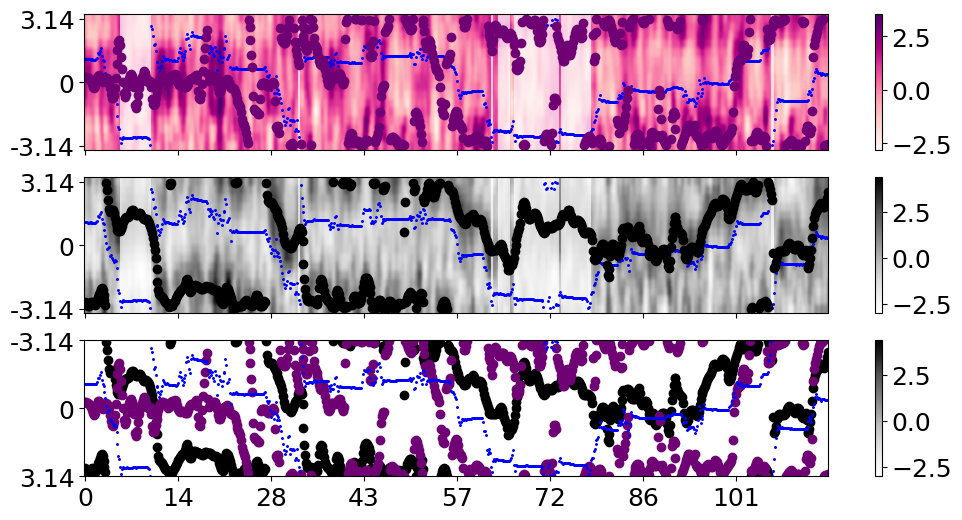

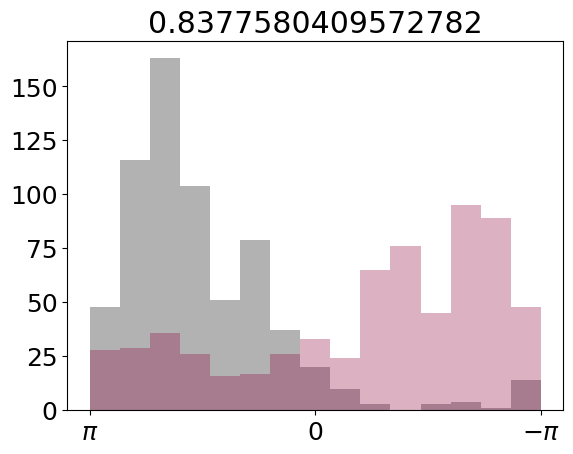

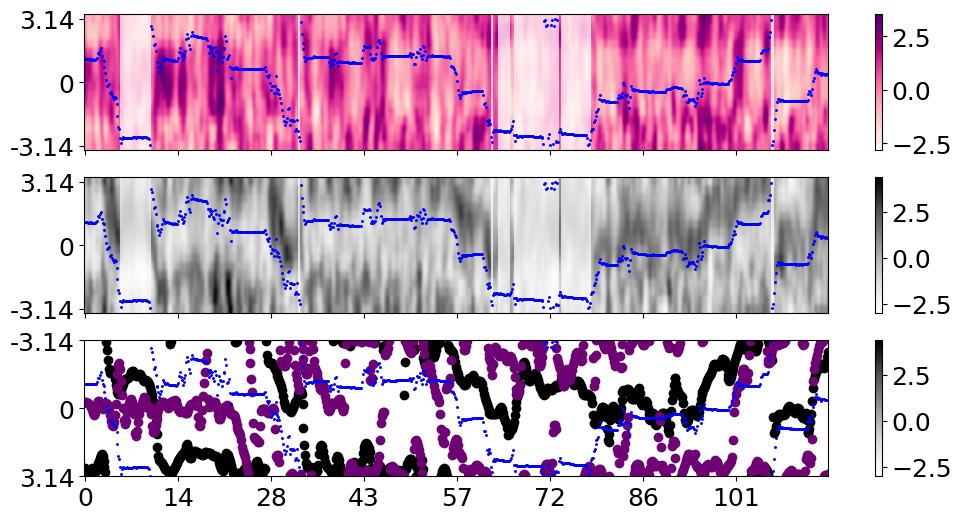

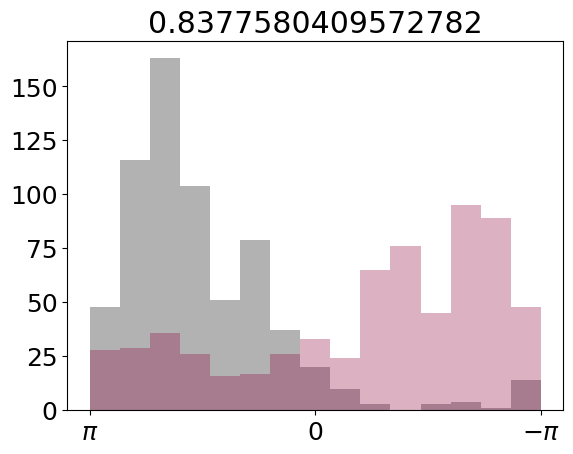

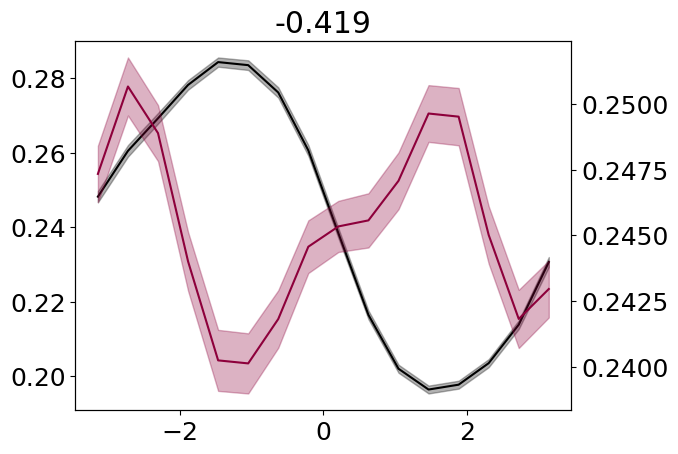

In [35]:
genotype = "ER4d_sytjGCaMP7f_EPG_jRGECO1a"
basedir = pathlib.Path(f'/media/mplitt/SSD_storage1/2PData/{genotype}')

date = '06_11_2023'
fly = 'fly1'
sess = 'closed_loop-002'

sess_pkl_dir = f'/media/mplitt/SSD_storage1/2P_scratch/{genotype}/{date}/{fly}/{sess}/data.pkl'

with open(sess_pkl_dir, 'rb') as file:
    data = cloudpickle.load(file)
print(data['df_aligned'].columns)
    
# heatmap, hist, diff = plot_dual_imaging(data, start_frame=200, stop_frame=1000, plot_time=False)
heatmap, hist, diff, diff_behind = plot_dual_imaging(data, start_frame=200, stop_frame=1000, plot_time=False)
outdir2 = pathlib.Path('/media/mplitt/SSD_storage1/fig_scratch/CortexClub_2023/')
# heatmap[0].savefig(outdir2.joinpath(f"{date}_{fly}_{sess}_eg_heatmap.pdf"))
# hist[0].savefig(outdir2.joinpath(f"{date}_{fly}_{sess}_eg_hist.pdf"))

heatmap, hist, diff, diff_behind = plot_dual_imaging(data, start_frame=200, stop_frame=1000,plot_time=False, pva_scatter=False)
outdir2 = pathlib.Path('/media/mplitt/SSD_storage1/fig_scratch/CortexClub_2023/')
# heatmap[0].savefig(outdir2.joinpath(f"{date}_{fly}_{sess}_eg_heatmap_noscat.pdf"))
# hist[0].savefig(outdir2.joinpath(f"{date}_{fly}_{sess}_eg_hist.pdf"))
plot_heading_centered_avg(data)

In [5]:
genotype = "ER4d_sytjGCaMP7f_EPG_jRGECO1a"
basedir = pathlib.Path(f'/media/mplitt/SSD_storage1/2PData/{genotype}')


date = '06_08_2023'
fly = 'fly1'
sess = 'baseline-004'

sess_pkl_dir = f'/media/mplitt/SSD_storage1/2P_scratch/{genotype}/{date}/{fly}/{sess}/data.pkl'

with open(sess_pkl_dir, 'rb') as file:
    data = cloudpickle.load(file)
print(data['df_aligned'].columns)
    
# heatmap, hist, diff = plot_dual_imaging(data, start_frame=200, stop_frame=1000, plot_time=False)
heatmap, hist, diff = plot_dual_imaging(data, start_frame=0, stop_frame=1000, plot_time=False, pva_scatter=False)

FileNotFoundError: [Errno 2] No such file or directory: '/media/mplitt/SSD_storage1/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/06_08_2023/fly1/baseline-004/data.pkl'

baseline-000
11_08_2023 fly2 baseline-000
1818
(2689,) 1818
open_loop-001
baseline-000
11_08_2023 fly1 baseline-000
1898
(2679,) 1898
baseline-000
11_08_2023 fly3 baseline-000
1782
(2536,) 1782
open_loop-002
baseline-000
10_10_2023 fly1 baseline-000
2104
(3066,) 2104
baseline-001
10_10_2023 fly1 baseline-001
2778
(3573,) 2778
closed_loop-002
30_10_2023 fly2 closed_loop-002
closed_loop-000
30_10_2023 fly2 closed_loop-000
1568
(2400,) 1568
closed_loop-001
30_10_2023 fly2 closed_loop-001
1617
(2400,) 1617
closed_loop_to_dark-004
closed_loop-000
30_10_2023 fly1 closed_loop-000
2236
(2761,) 2236


/tmp/ipykernel_519455/181479041.py:107: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


closed_loop_to_dark-005
closed_loop-003
30_10_2023 fly1 closed_loop-003
1988
(2761,) 1988
closed_loop-001
30_10_2023 fly1 closed_loop-001
2143
(2761,) 2143
closed_loop-000
30_10_2023 fly3 closed_loop-000
1585
(2400,) 1585
closed_loop-000
06_11_2023 fly2 closed_loop-000
closed_loop-002
06_11_2023 fly1 closed_loop-002
1980
(2496,) 1980
closed_loop-000
06_11_2023 fly1 closed_loop-000
1796
(2807,) 1796
open_loop-004
baseline-001
06_08_2023 fly2 baseline-001
1773
(2565,) 1773
dark-003
dark-005
baseline-004
06_08_2023 fly1 baseline-004
baseline-000
07_08_2023 fly1 baseline-000
1239
(2183,) 1239
baseline-000
07_08_2023 fly3 baseline-000
1553
(2185,) 1553
baseline-001
07_08_2023 fly3 baseline-001
1283
(2185,) 1283
baseline-000
12_10_2023 fly2 baseline-000
1784
(2974,) 1784
baseline-001
12_10_2023 fly2 baseline-001
1449
(2974,) 1449
baseline_to_dark-002
baseline-000
12_10_2023 fly1 baseline-000
baseline-000
12_10_2023 fly3 baseline-000
1793
(2974,) 1793
baseline-001
12_10_2023 fly3 baseline-001

/tmp/ipykernel_519455/181479041.py:93: RuntimeWarning: invalid value encountered in cast
  max_inds = (15*(heading+np.pi)/2/np.pi).astype(int)
/tmp/ipykernel_519455/181479041.py:97: RuntimeWarning: overflow encountered in scalar negative
  dff_EB_maxal[:,t] = np.roll(dff_EB[:,t], -max_inds[t]-8)
/tmp/ipykernel_519455/181479041.py:97: RuntimeWarning: overflow encountered in scalar subtract
  dff_EB_maxal[:,t] = np.roll(dff_EB[:,t], -max_inds[t]-8)
/tmp/ipykernel_519455/181479041.py:98: RuntimeWarning: overflow encountered in scalar negative
  dff_R4d_maxal[:,t] = np.roll(dff_R4d[:,t], -max_inds[t]-8)
/tmp/ipykernel_519455/181479041.py:98: RuntimeWarning: overflow encountered in scalar subtract
  dff_R4d_maxal[:,t] = np.roll(dff_R4d[:,t], -max_inds[t]-8)


closed_loop-001
31_10_2023 fly4 closed_loop-001
910
(2644,) 910
closed_loop-003
28_10_2023 fly2 closed_loop-003
2024
(2736,) 2024
closed_loop-001
28_10_2023 fly2 closed_loop-001
2132
(2736,) 2132
closed_loop-000
28_10_2023 fly1 closed_loop-000
1557
(2666,) 1557
closed_loop-000
28_10_2023 fly3 closed_loop-000
1894
(3161,) 1894
closed_loop-001
28_10_2023 fly3 closed_loop-001
1871
(3161,) 1871


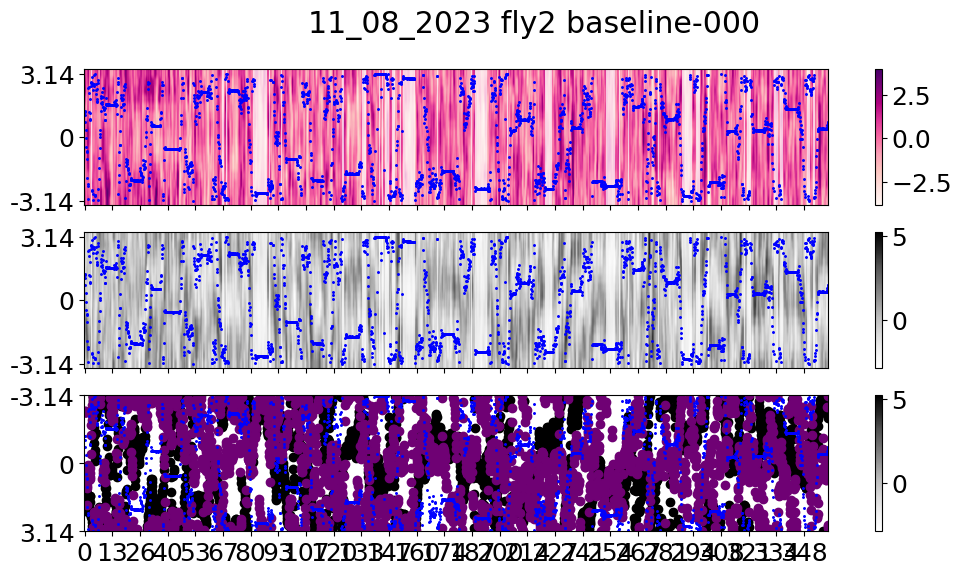

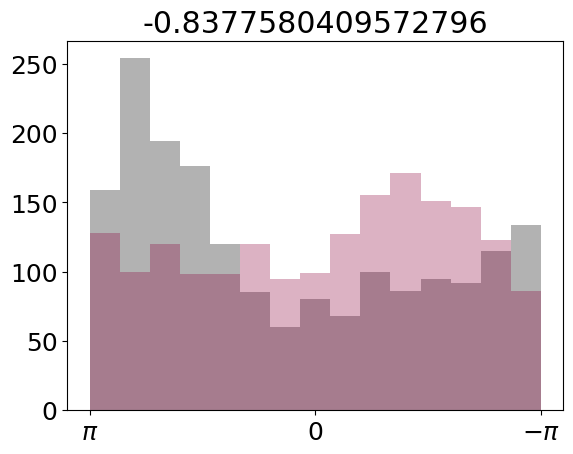

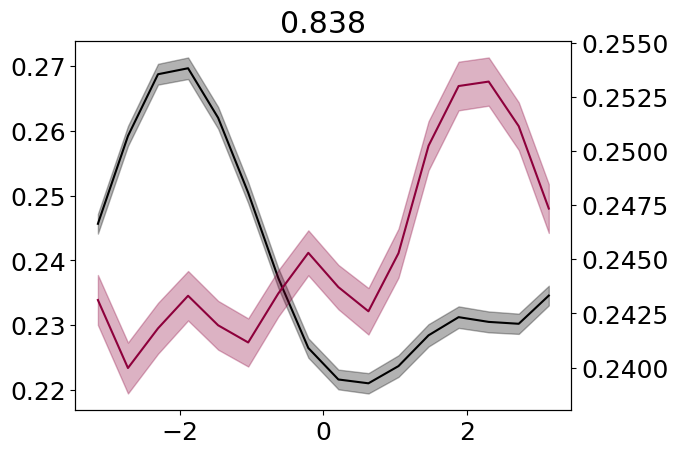

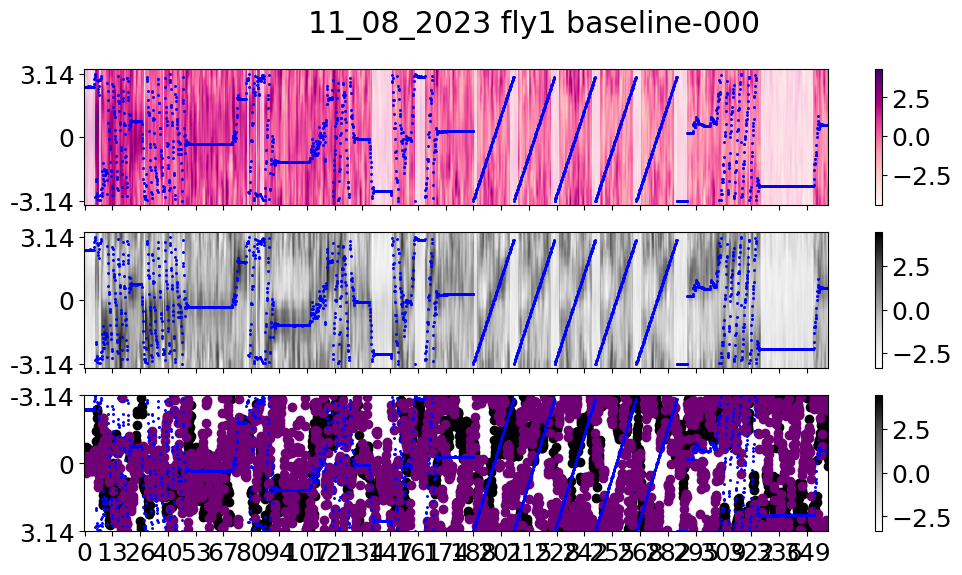

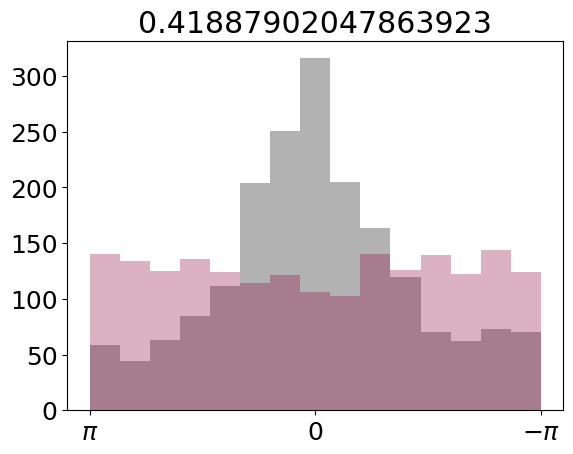

...

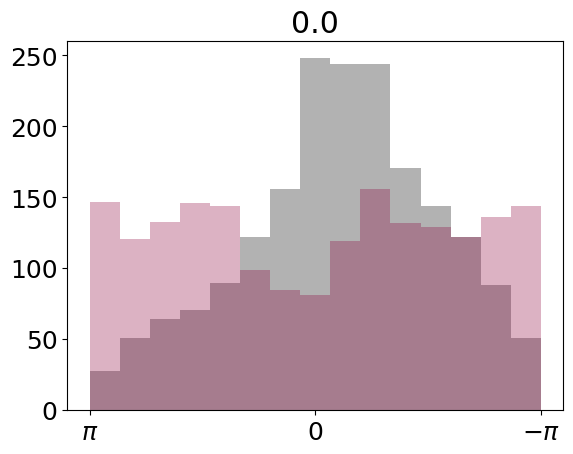

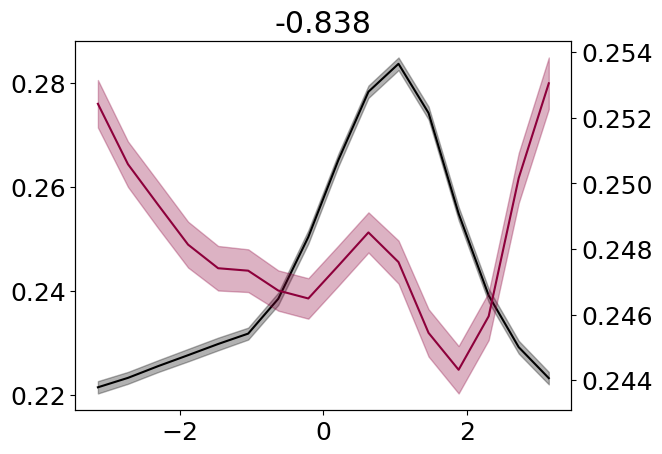

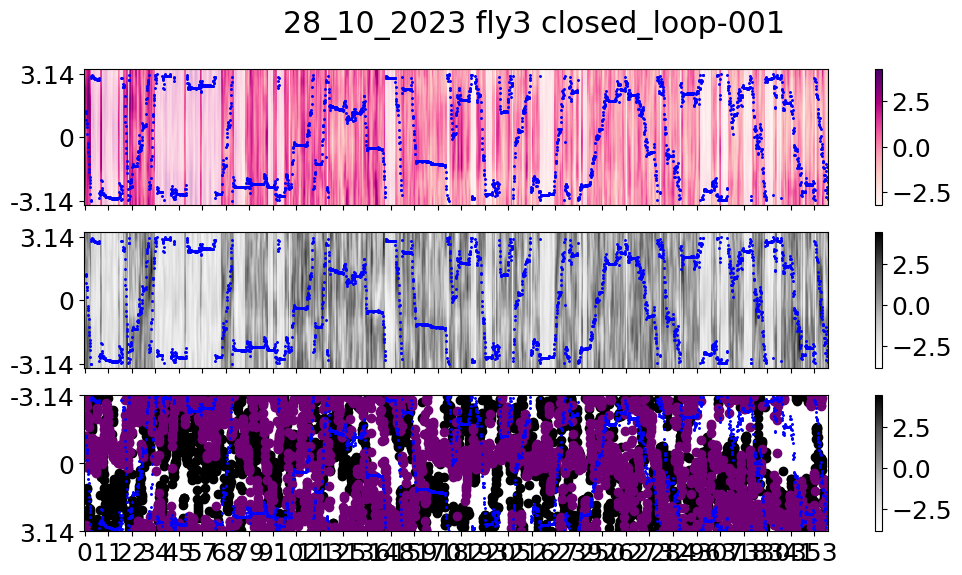

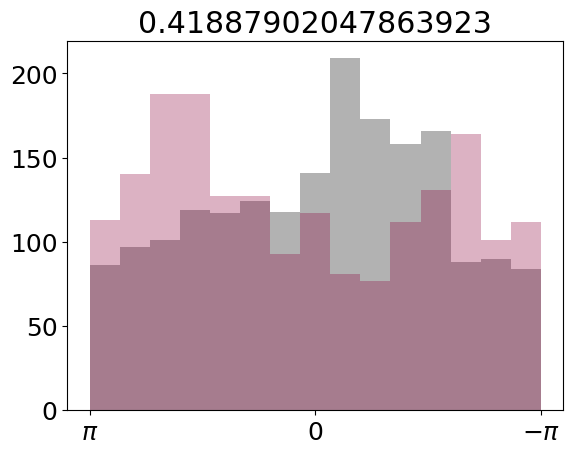

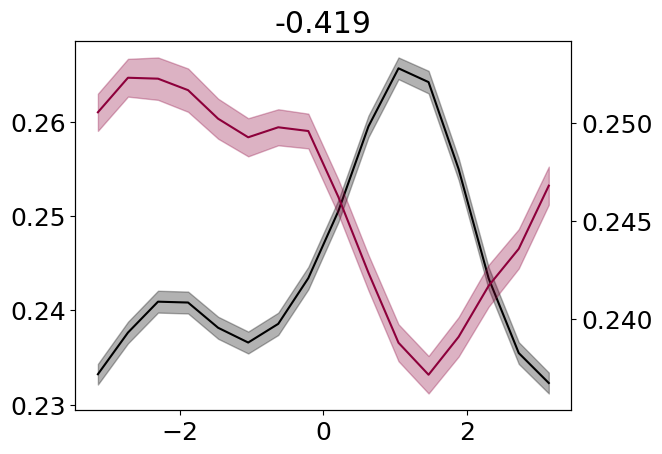

In [43]:
genotype = "ER4d_sytjGCaMP7f_EPG_jRGECO1a"
basedir = pathlib.Path(f'/media/mplitt/SSD_storage1/2PData/{genotype}')


diff_vec = []
diff_behind_vec = []
for date_dir in basedir.glob('*'):
    date = date_dir.stem
    
    
    for fly_dir in date_dir.glob('fly*'): 
        _diff = np.nan
        _diff_behind = np.nan
        fly = fly_dir.stem
        
        for i, sess_dir in enumerate(fly_dir.glob("*")):
            
            if sess_dir.is_dir() and "SingleImage" not in sess_dir.stem:
                sess = sess_dir.stem
                print(sess)
                if 'baseline' in sess_dir.stem or 'closed_loop' in sess_dir.stem:
                    if not ('dark' in sess_dir.stem) :

                        print(date, fly, sess)
                        sess_pkl_dir = f'/media/mplitt/SSD_storage1/2P_scratch/{genotype}/{date}/{fly}/{sess}/data.pkl'
                        if os.path.exists(sess_pkl_dir):
                            with open(sess_pkl_dir, 'rb') as file:
                                data = cloudpickle.load(file)
                                # print(data.keys())



                            heatmap, hist, diff, diff_behind = plot_dual_imaging(data, start_frame=0, stop_frame=-1, plot_time=False, pva_scatter=False)
                            heatmap[0].suptitle(f"{date} {fly} {sess}")
                            # diff = plot_heading_centered_avg(data)[0]

                            if i==0:
                                _diff=0
                                _diff_behind = 0
                            _diff += diff
                            _diff_behind += diff_behind
        diff_vec.append(_diff/(i+1.))
        diff_behind_vec.append(_diff_behind/(i+1.))

In [44]:
diff_vec

[nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 1.0471975511965976,
 nan,
 0.0,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 -1.2566370614359172,
 nan,
 0.5864306286700948,
 -0.1675516081914556,
 nan,
 0.5235987755982987,
 0.0,
 -0.3141592653589793]

0.48694686130641784


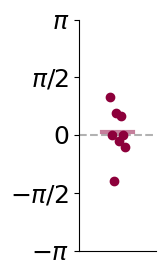

In [45]:
diff_vec = np.array(diff_vec)
diff_vec =diff_vec[~np.isnan(diff_vec)]

fig, ax = plt.subplots(figsize=[1,3])
ax.scatter(np.linspace(-.1,.1, num=diff_vec.shape[0]), diff_vec, color=plt.cm.PuRd(.9))
ax.plot([-.2, .2], np.angle(np.exp(1j*diff_vec).mean())*np.ones((2,)), linewidth=3, color=plt.cm.PuRd(.9), alpha=.5)

ax.set_ylim([-np.pi, np.pi])
ax.set_yticks([-np.pi, -np.pi/2, 0, np.pi/2, np.pi], labels=[r'$-\pi$', r'$-\pi/2$', 0, r'$\pi/2$', r'$\pi$'])
ax.set_xlim([-.5,.5])
ax.plot([-.5,.5],[0,0], 'k--', zorder=-10, alpha=.3)
ax.set_xticks([]) 

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
print(np.abs(diff_vec).mean())
# fig.savefig(outdir.joinpath("across_fly_offset_diff.pdf"))

0.5576326960121882


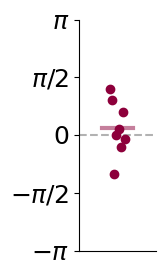

In [46]:
diff_behind_vec = np.array(diff_behind_vec)
diff_behind_vec =diff_behind_vec[~np.isnan(diff_behind_vec)]

fig, ax = plt.subplots(figsize=[1,3])
ax.scatter(np.linspace(-.1,.1, num=diff_behind_vec.shape[0]), diff_behind_vec, color=plt.cm.PuRd(.9))
ax.plot([-.2, .2], np.angle(np.exp(1j*diff_behind_vec).mean())*np.ones((2,)), linewidth=3, color=plt.cm.PuRd(.9), alpha=.5)

ax.set_ylim([-np.pi, np.pi])
ax.set_yticks([-np.pi, -np.pi/2, 0, np.pi/2, np.pi], labels=[r'$-\pi$', r'$-\pi/2$', 0, r'$\pi/2$', r'$\pi$'])
ax.set_xlim([-.5,.5])
ax.plot([-.5,.5],[0,0], 'k--', zorder=-10, alpha=.3)
ax.set_xticks([]) 

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
print(np.abs(diff_behind_vec).mean())